#Part 2: Image Mosaics


##Imports

In [ ]:
import numpy as np
import cv2 
from google.colab.patches import cv2_imshow
import matplotlib as mpl
import matplotlib.pyplot as plt
import math

##Loading Images

In [ ]:
First_Image = cv2.imread("/content/image2.jpg")
image1 = cv2.imread("/content/image2.jpg")
Second_Image = cv2.imread("/content/image1.jpg")
image2 = cv2.imread("/content/image1.jpg")

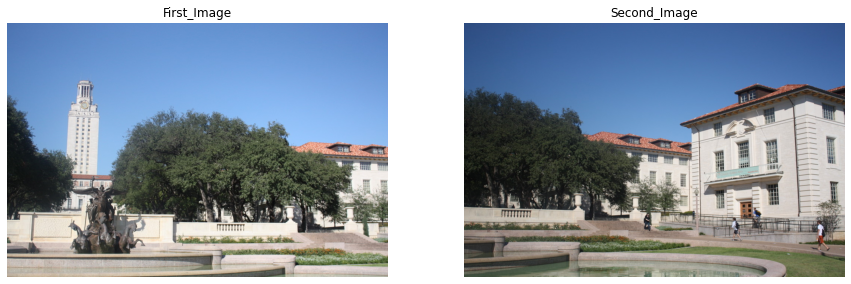

In [ ]:
fig,ax=plt.subplots(nrows=1,ncols=2,figsize=(15,15))
ax=ax.flatten()
ax[0].imshow(cv2.cvtColor(First_Image , cv2.COLOR_BGR2RGB));
ax[0].title.set_text("First_Image");
ax[0].axis("off");
ax[1].imshow(cv2.cvtColor(Second_Image, cv2.COLOR_BGR2RGB));
ax[1].title.set_text("Second_Image");
ax[1].axis("off");


# **2.1 Getting Correspondences and Compute the Homography Parameters**

##Using Sift descriptor to find keypoints in each image

###Getting key points using sift descriptor

In [ ]:
# Initiate SIFT detector
sift = cv2.xfeatures2d.SIFT_create()

# find the keypoints and descriptors with SIFT
key_points_1, dest1 = sift.detectAndCompute(First_Image,None)
key_points_2, dest2 = sift.detectAndCompute(Second_Image,None)
print ("Found keypoints in image 2: " + str(len(key_points_1)))
print ("Found keypoints in image 1: " + str(len(key_points_2)))

Found keypoints in image 2: 5314
Found keypoints in image 1: 4195


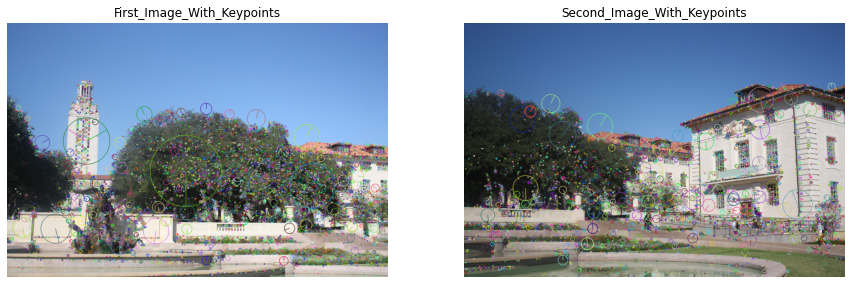

In [ ]:
img1=cv2.drawKeypoints(First_Image ,
                      key_points_1 ,
                      First_Image ,
                      flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
cv2.imwrite('image1-with-keypoints.jpg', img1)
img2=cv2.drawKeypoints(Second_Image ,
                      key_points_2 ,
                      Second_Image ,
                      flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
cv2.imwrite('image2-with-keypoints.jpg', img2)
fig,ax=plt.subplots(nrows=1,ncols=2,figsize=(15,15))
ax=ax.flatten()
ax[0].imshow(cv2.cvtColor(img1 , cv2.COLOR_BGR2RGB));
ax[0].title.set_text("First_Image_With_Keypoints");
ax[0].axis("off");
ax[1].imshow(cv2.cvtColor(img2, cv2.COLOR_BGR2RGB));
ax[1].title.set_text("Second_Image_With_Keypoints");
ax[1].axis("off");

###Getting and Plotting Matching points using BFMatcher and knn=2

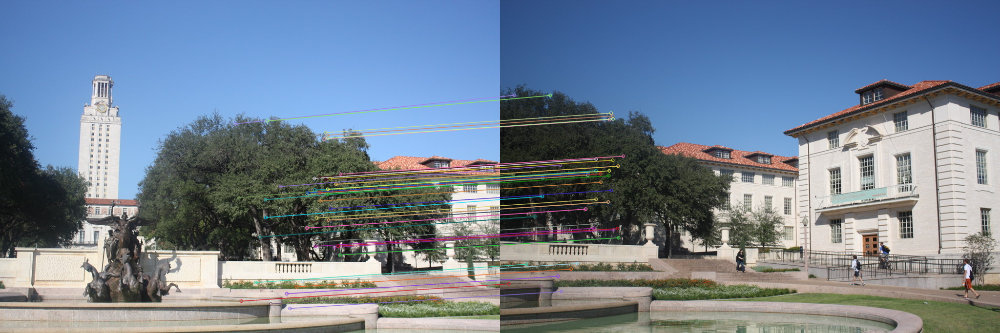

In [ ]:
brute_force_matcher = cv2.BFMatcher(cv2.NORM_L2, crossCheck = False)
matches = brute_force_matcher.knnMatch(dest1,dest2, k=2)
good = []
good_without_list = []
for m,n in matches:
    if m.distance < 0.3*n.distance:
        good.append([m])
        good_without_list.append(m)

# cv2.drawMatchesKnn expects list of lists as matches.
img3 = cv2.drawMatchesKnn(image1,key_points_1,image2,key_points_2,good[:50],image2,flags=2)

cv2_imshow(img3)

In [ ]:
kps_a = []
kps_b = []
matches=good_without_list[:50]
for match in matches:
    # Get the matching keypoints for each of the images
    img_a_idx = match.queryIdx
    img_b_idx = match.trainIdx
    # Get the coordinates
    (x1,y1) = key_points_1[img_a_idx].pt
    (x2,y2) = key_points_2[img_b_idx].pt
    # Append to each list
    kps_a.append((x1, y1))
    kps_b.append((x2, y2))   


In [ ]:
kps_a = np.asarray(kps_a)
kps_b = np.asarray(kps_b)

##Homography Matrix

In [ ]:
def get_coordinates(kps,index):
  point = kps[index]
  return point[0] , point[1]
def get_sub_a_matrix(x,y,x_,y_):
  matrix=np.zeros((2,8))
  matrix[0]=np.array([x, y,1,0,0,0, -x*x_, -y*x_])
  matrix[1]=np.array([0,0,0,x, y,1, -x*y_, -y*y_])
  return matrix  
def get_homography_matrix(kps_a,kps_b):
  n=len(kps_a)
  #build b 
  b = np.zeros(((2*n),1))
  for i in range(n):
    b[2*i], b[2*i +1]=get_coordinates(kps_b,i)
  # build a
  a = np.zeros(((2*n),8))
  for i in range(n):
    x,y=get_coordinates(kps_a,i)
    x_,y_=get_coordinates(kps_b,i)
    sub_a_matrix=get_sub_a_matrix(x,y,x_,y_)
    a[2*i] = sub_a_matrix[0]
    a[2*i + 1] = sub_a_matrix[1]		
  # Solve equations to compute H
  H=np.linalg.lstsq(a, b)[0]
  H=np.append(H,1)
  H=np.reshape(H,(3,3))
  return H
    

In [ ]:
H=get_homography_matrix(kps_a,kps_b)
H

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:24: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.


array([[ 1.26222850e+00, -7.61000808e-02, -5.56151802e+02],
       [ 1.60858045e-01,  1.17534253e+00, -1.56301362e+02],
       [ 2.55388281e-04, -1.67374699e-05,  1.00000000e+00]])

##Verification of H matrix

In [ ]:
h_veri,status = cv2.findHomography(kps_a, kps_b)
h_veri

array([[ 1.27659328e+00, -7.64377019e-02, -5.62887264e+02],
       [ 1.67396561e-01,  1.18878051e+00, -1.61533814e+02],
       [ 2.71399501e-04, -1.25882514e-05,  1.00000000e+00]])

# **2.2 Warping Between Image Planes**

#Warping


In [ ]:
def getValues(img,H):
  coords = dict()
  minX = 0x7fffffff
  minY = 0x7fffffff
  maxX = -1 * 0x7fffffff
  maxY = -1 * 0x7fffffff
  for row in range(img.shape[0]):
    for col in range(img.shape[1]):
      homgCoords = np.array([(col, row, 1)]).T
      transformedCoords = H.dot(homgCoords)
      transformedCoords = transformedCoords/transformedCoords[2];
      newX, newY = int(transformedCoords[0]),int(transformedCoords[1])
      coords[row,col]=np.array([(newX, newY)])
      minX = min(minX, newX)
      minY = min(minY, newY)
      maxX = max(maxX, newX)
      maxY = max(maxY, newY)
  return minX, minY, maxX, maxY, coords

In [ ]:
def warping(img, H):
  minX, minY, maxX, maxY, coords = getValues(img,H)
  shiftX = minX * -1
  shiftY = minY * -1
  #we have three channels (red, blue, green)
  warpedImage = np.zeros(((maxY - minY) + 2, (maxX - minX) + 2, 3, 2))
  returnImage = np.zeros(((maxY - minY) + 2, (maxX - minX) + 2, 3))

  rows_num = img.shape[0]
  columns_num = img.shape[1]
  for row in range(rows_num):
    for col in range(columns_num):
      #calculating the new positions of the pixels
      newX, newY = coords[row,col][0][0], coords[row,col][0][1]
      newX += shiftX
      newY += shiftY
      subpixels = np.array([(newX,newY),(newX+1,newY),(newX,newY+1),(newX+1,newY+1)])
      for subpixel in subpixels:
            for channel in range(3):
              warpedImage[subpixel[1]][subpixel[0]][channel][0] += 1
              warpedImage[subpixel[1]][subpixel[0]][channel][1] += img[row][col][channel]

  rows_num2 = warpedImage.shape[0]
  columns_num2 = warpedImage.shape[1]
  for row in range(rows_num2):
   for col in range(columns_num2):
       for channel in range(3):
        if warpedImage[row][col][channel][0] > 0:
           returnImage[row][col][channel] = (warpedImage[row][col][channel][1]) // (warpedImage[row][col][channel][0])
        
  return shiftX, shiftY, returnImage

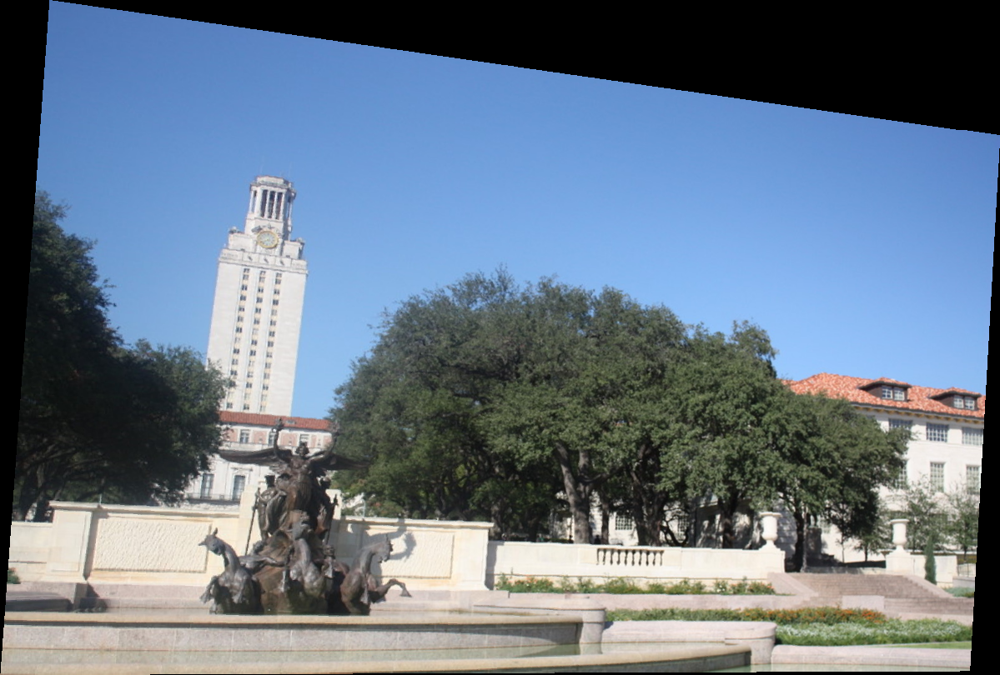

In [ ]:
shiftX, shiftY, warpedImg = warping(image1,H)
cv2_imshow(warpedImg)

# Inverse warping to avoid holes

In [ ]:
def inverse_warping(warpedImg, originalImg, H):
  #getting the inverse homography matrix
  Hinv = np.linalg.pinv(H)

  rows_num = warpedImg.shape[0]
  columns_num = warpedImg.shape[1]
  #checking for the black holes
  for row in range(rows_num):
    for col in range(columns_num):
      black_count = 0
      for channel in range(3):
        black_count += warpedImg[row][col][channel]
      
      #if black holes found, perform warping with inverse homography matrix
      if black_count == 0:
        homgCoords = np.array([(col, row, 1)]).T
        transformedCoords = Hinv.dot(homgCoords)
        transformedCoords = transformedCoords/transformedCoords[2];
        newfX, newfY = int(transformedCoords[0]),int(transformedCoords[1])
        
        #getting the correct colour of the pixel from the original image
        if newfX >=0 and newfX < (originalImg.shape[1]-1) and newfY>=0 and newfY < (originalImg.shape[0]-1):
          xx = np.array([(1-newfX, newfX)])
          yy = np.array([(1-newfY, newfY)]).T
          for channel in range(img.shape[2]):
            colorMatrix = np.array([(originalImg[int(newfY)][int(newfX)][channel],originalImg[int(newfY)+1][int(newfX)][channel])],
                                   [(originalImg[int(newfY)][int(newfX)+1][channel],originalImg[int(newfY)+1][int(newfX)+1][channel])])
            img[row][col][channel] = xx.dot(colorMatrix).dot(yy)

  return warpedImg

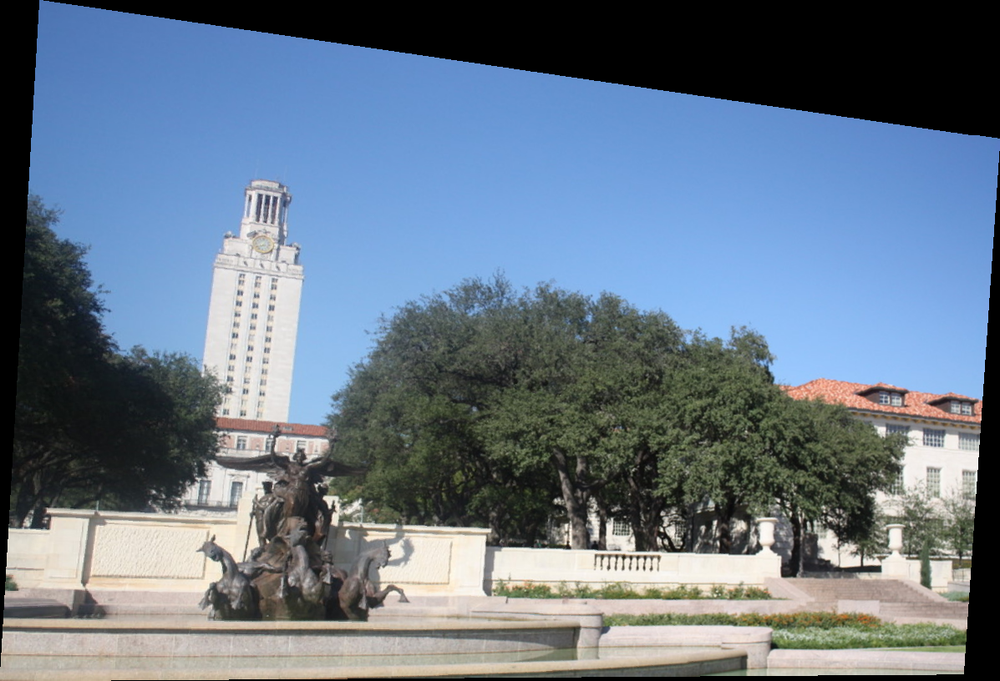

In [ ]:
invWarpedImg = inverse_warping(warpedImg, image1, H)
cv2_imshow(invWarpedImg)

# **2.3 Create the output mosaic**

In [ ]:
def stitchImages(originalImg, warpedImg, shiftX, shiftY):
  #creating a new image large enough to accommodate the two stitched images
  newImg = np.zeros(((originalImg.shape[0] + warpedImg.shape[0]), (originialImg.shape[1] + warpedImg.shape[1]), 3))
  newImg[0:warpedImg.shape[0],0:warpedImg.shape[1]] = warpedImg
  
  rows_num = originalImg.shape[0]
  columns_num = originalImg.shape[1]
  for row in range(rows_num):
    for col in range(columns_num):
      newX, newY = col + shiftX , row + shiftY
      newImg[newY][newX] = originalImg[row][col]

  # delete black rows & columns
  idx = np.argwhere(np.all(newImg[..., :] == 0, axis=0))
  newImg = np.delete(newImg, idx, axis=1)
  idx = np.argwhere(np.all(newImg[..., :] == 0, axis=1))
  newImg = np.delete(newImg, idx, axis=0)
  
  # rotate image columns if shift was -ve 
  if shiftX < 0:
    newImg = np.roll(newImg, -1* shiftX, axis=1)
  if shiftY < 0:
    newImg = np.roll(newImg, -1* shiftY, axis=0)
    
  return newImg

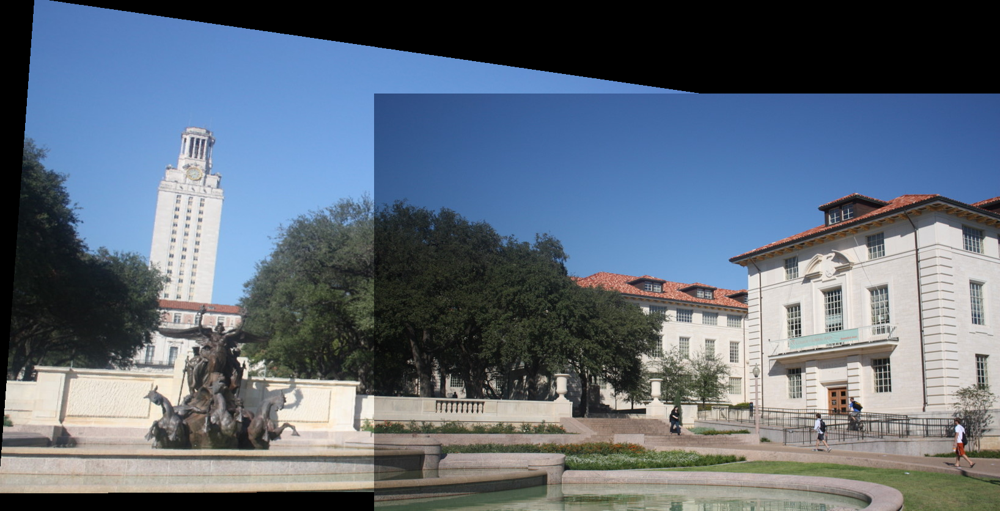

In [ ]:
outputImg = stitchImages(image2, warpedImg, shiftX, shiftY)
cv2_imshow(outputImg)

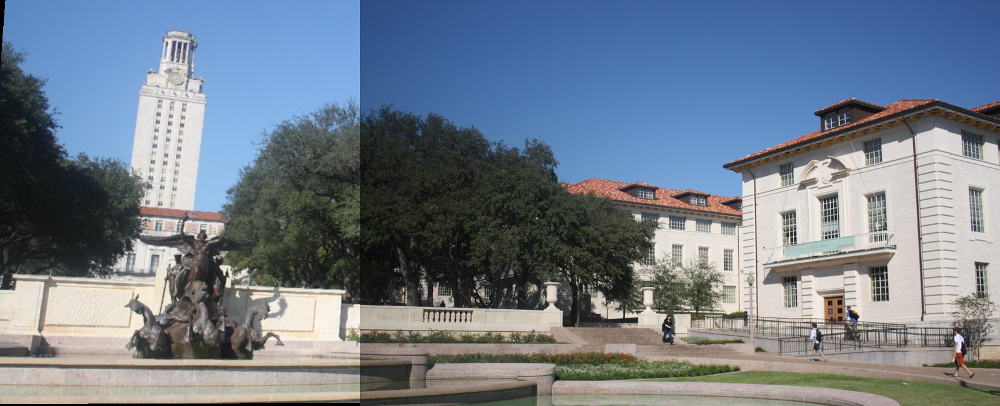

In [ ]:
outputImg.shape
outputImg = outputImg[159:810, 36:]
cv2_imshow(outputImg)

In [ ]:
H=get_homography_matrix(kps_b,kps_a)
H

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:24: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.


array([[ 7.73495429e-01,  5.26283960e-02,  4.45574017e+02],
       [-1.38250961e-01,  9.31386689e-01,  7.36278094e+01],
       [-2.13100869e-04, -6.07706904e-06,  1.00000000e+00]])

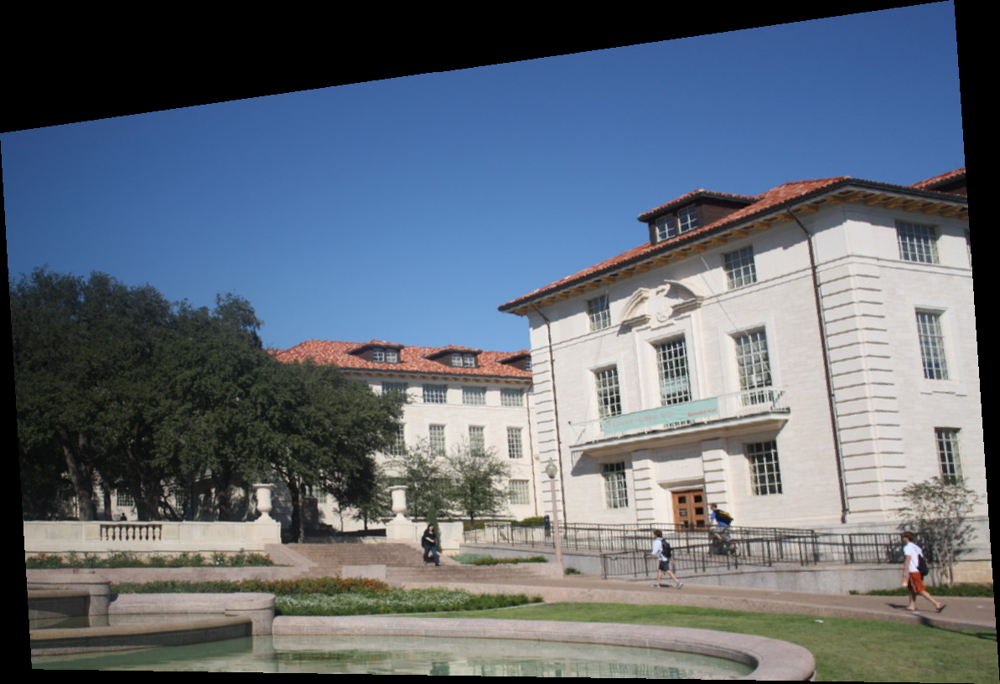

In [ ]:
shiftX, shiftY, warpedImg = warping(image2,H)
cv2_imshow(warpedImg)

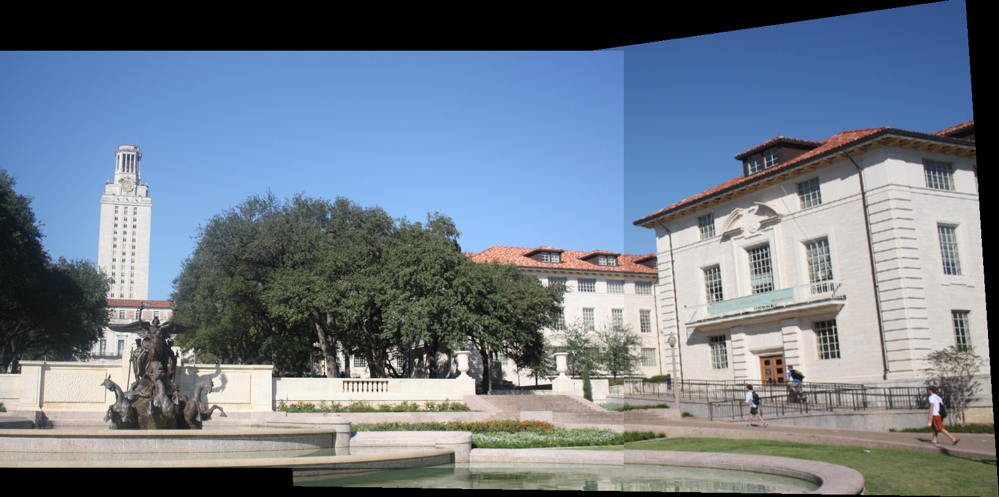

In [ ]:
outputImg = stitchImages(image1, warpedImg, shiftX, shiftY)
cv2_imshow(outputImg)

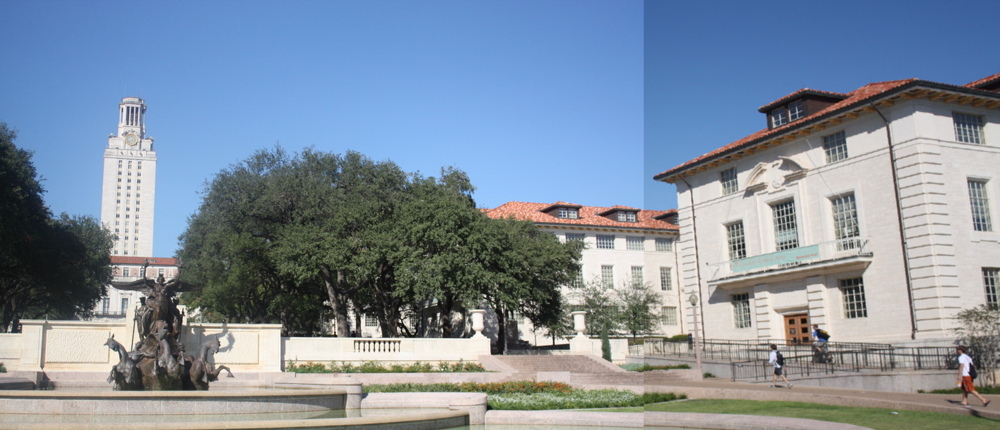

In [ ]:
outputImg.shape
outputImg = outputImg[83:766, :1586]
cv2_imshow(outputImg)

#2 images of our own

##Loading images

In [ ]:
new1 = cv2.imread("/content/new1.jpg")
new2 = cv2.imread("/content/new2.jpg")
new1_copy = cv2.imread("/content/new1.jpg")
new2_copy = cv2.imread("/content/new2.jpg")

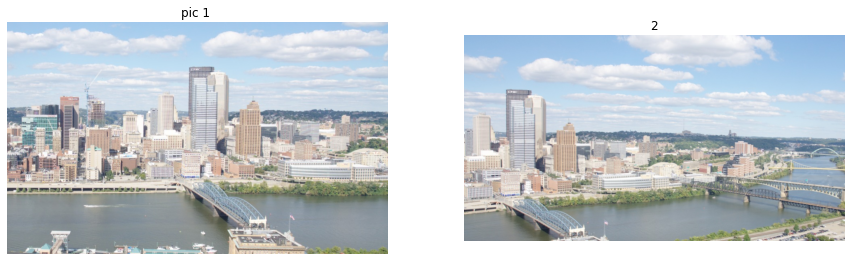

In [ ]:
fig,ax=plt.subplots(nrows=1,ncols=2,figsize=(15,15))
ax=ax.flatten()
ax[0].imshow(cv2.cvtColor(new1 , cv2.COLOR_BGR2RGB));
ax[0].title.set_text("pic 1 ");
ax[0].axis("off");
ax[1].imshow(cv2.cvtColor(new2 , cv2.COLOR_BGR2RGB));
ax[1].title.set_text("2");
ax[1].axis("off");


##Sift

In [ ]:
kp_new1, des1 = sift.detectAndCompute(new1,None)
kp_new2, des3 = sift.detectAndCompute(new2,None)
print ("Found keypoints in image 1: " + str(len(new1)))
print ("Found keypoints in image 3: " + str(len(kp_new2)))

Found keypoints in image 1: 576
Found keypoints in image 3: 4769


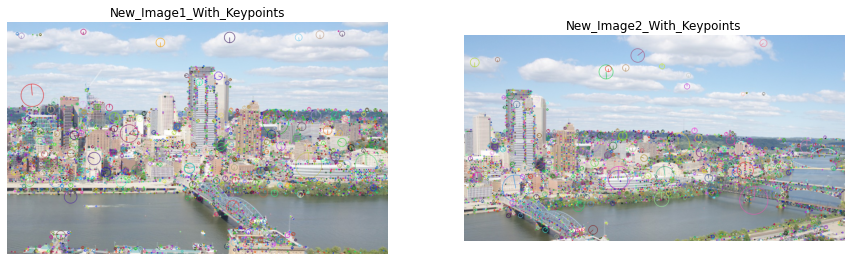

In [ ]:
img1new=cv2.drawKeypoints(new1,
                      kp_new1 ,
                      new1 ,
                      flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
cv2.imwrite('image1-with-keypoints.jpg', img1new)
img2new=cv2.drawKeypoints(new2 ,
                      kp_new2 ,
                      new2 ,
                      flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
cv2.imwrite('image2-with-keypoints.jpg', img2new)
fig,ax=plt.subplots(nrows=1,ncols=2,figsize=(15,15))
ax=ax.flatten()
ax[0].imshow(cv2.cvtColor(img1new , cv2.COLOR_BGR2RGB));
ax[0].title.set_text("New_Image1_With_Keypoints");
ax[0].axis("off");
ax[1].imshow(cv2.cvtColor(img2new, cv2.COLOR_BGR2RGB));
ax[1].title.set_text("New_Image2_With_Keypoints");
ax[1].axis("off");

##Getting Matches

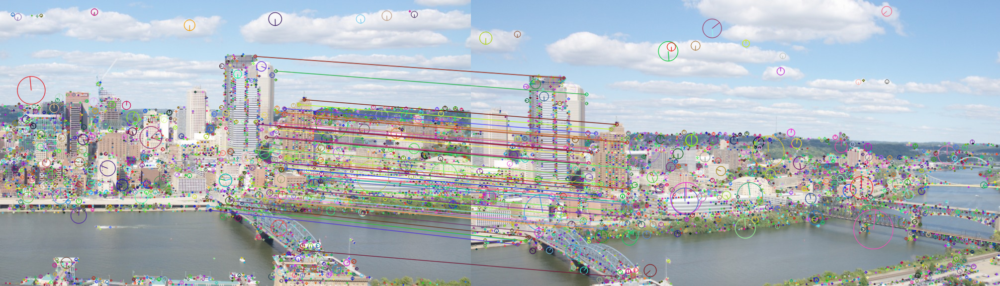

In [ ]:
new_matches = brute_force_matcher.knnMatch(des1,des3, k=2)
good = []
good_without_list = []
for m,n in new_matches:
    if m.distance < 0.3*n.distance:
        good.append([m])
        good_without_list.append(m)

# cv2.drawMatchesKnn expects list of lists as matches.
new = cv2.drawMatchesKnn(new1,kp_new1,new2,kp_new2,good[:50],new2,flags=2)

cv2_imshow(new)

In [ ]:
kps_new1 = []
kps_new2 = []
matches_new=good_without_list[:50]
for match in matches_new:
    # Get the matching keypoints for each of the images
    img_a_idx = match.queryIdx
    img_b_idx = match.trainIdx
    # Get the coordinates
    (x1,y1) = kp_new1[img_a_idx].pt
    (x2,y2) = kp_new2[img_b_idx].pt
    # Append to each list
    kps_new1.append((x1, y1))
    kps_new2.append((x2, y2))   
kps_new1 = np.asarray(kps_new1)
kps_new2 = np.asarray(kps_new2)

##Homography matrix

In [ ]:
H_new12=get_homography_matrix(kps_new1,kps_new2)
H_new12

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:24: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.


array([[ 1.49871194e+00,  4.72840267e-02, -5.39853180e+02],
       [ 1.38385238e-01,  1.34398611e+00, -2.37181799e+01],
       [ 5.18522354e-04,  1.74200019e-05,  1.00000000e+00]])

##Verification


In [ ]:
h_veri,status = cv2.findHomography(kps_new1,kps_new2)
h_veri

array([[ 1.50853864e+00,  4.79567686e-02, -5.43813614e+02],
       [ 1.42809249e-01,  1.35179275e+00, -2.60249716e+01],
       [ 5.30315480e-04,  1.90633261e-05,  1.00000000e+00]])

##Warping

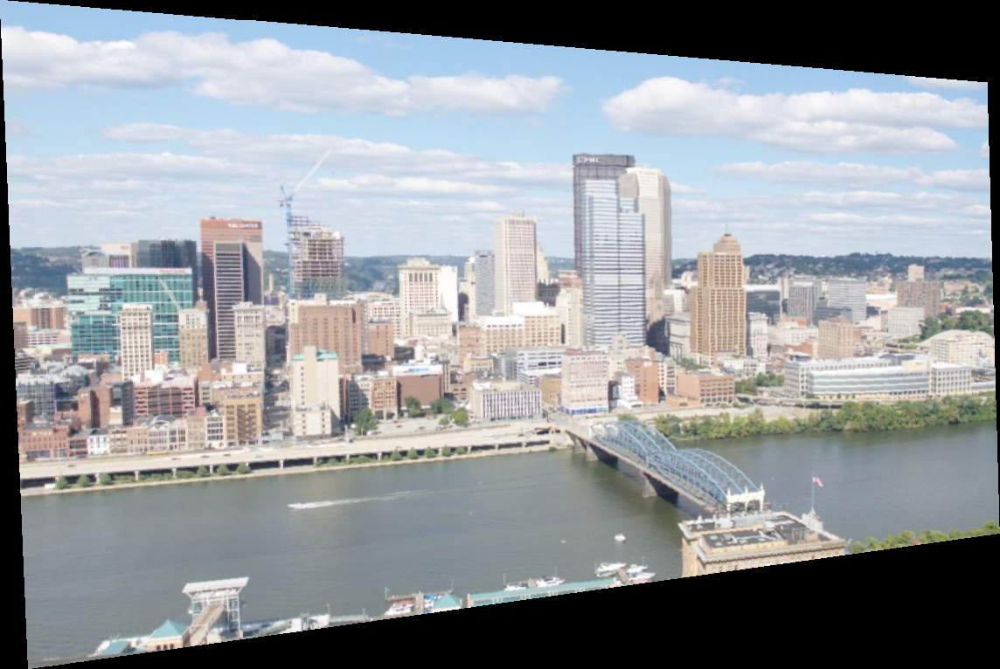

In [ ]:
shiftX, shiftY, warpedImg = warping(new1_copy,H_new12)
cv2_imshow(warpedImg)

##Stitching

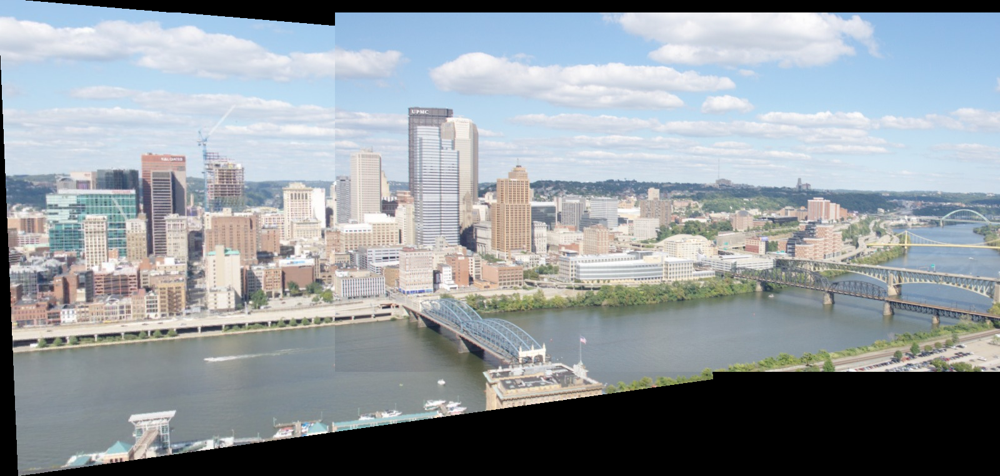

In [ ]:
new12_output = stitchImages(new2_copy, warpedImg, shiftX, shiftY)
cv2_imshow(new12_output)

#Bonus

##Loading Images

In [ ]:
shanghai1 = cv2.imread("/content/shanghai-21.png")
shanghai3 = cv2.imread("/content/shanghai-23.png")
shanghai2 = cv2.imread("/content/shanghai-22.png")
shanghai1_copy = cv2.imread("/content/shanghai-21.png")
shanghai2_copy = cv2.imread("/content/shanghai-22.png")
shanghai3_copy = cv2.imread("/content/shanghai-23.png")

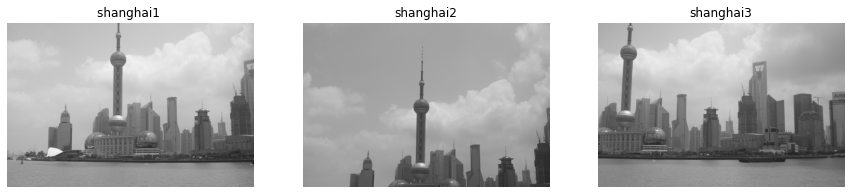

In [ ]:
fig,ax=plt.subplots(nrows=1,ncols=3,figsize=(15,15))
ax=ax.flatten()
ax[0].imshow(cv2.cvtColor(shanghai1  , cv2.COLOR_BGR2RGB));
ax[0].title.set_text("shanghai1 ");
ax[0].axis("off");
ax[1].imshow(cv2.cvtColor(shanghai2 , cv2.COLOR_BGR2RGB));
ax[1].title.set_text("shanghai2");
ax[1].axis("off");
ax[2].imshow(cv2.cvtColor(shanghai3 , cv2.COLOR_BGR2RGB));
ax[2].title.set_text("shanghai3");
ax[2].axis("off");


##Sift  (I'll warp image 1 with 3 then the result with 2)

###Getting Key Points using Sift descriptor

In [ ]:
# find the keypoints and descriptors with SIFT
kp_shang_1, des1 = sift.detectAndCompute(shanghai1,None)
kp_shang_3, des3 = sift.detectAndCompute(shanghai3,None)
print ("Found keypoints in image 1: " + str(len(kp_shang_1)))
print ("Found keypoints in image 3: " + str(len(kp_shang_3)))

Found keypoints in image 1: 1004
Found keypoints in image 3: 1136


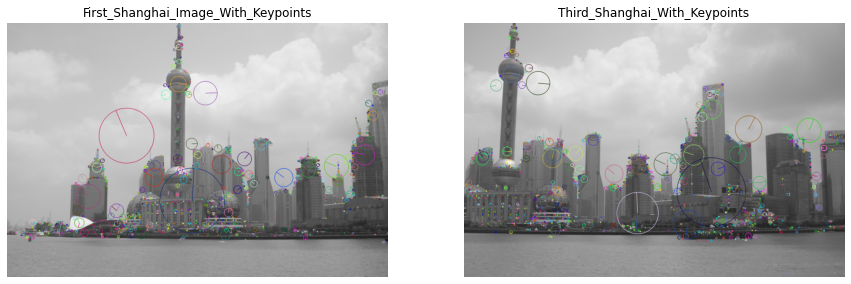

In [ ]:
img1shang=cv2.drawKeypoints(shanghai1,
                      kp_shang_1 ,
                      shanghai1 ,
                      flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
cv2.imwrite('image1-with-keypoints.jpg', img1shang)
img3shang=cv2.drawKeypoints(shanghai3 ,
                      kp_shang_3 ,
                      shanghai3 ,
                      flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
cv2.imwrite('image2-with-keypoints.jpg', img3shang)
fig,ax=plt.subplots(nrows=1,ncols=2,figsize=(15,15))
ax=ax.flatten()
ax[0].imshow(cv2.cvtColor(img1shang , cv2.COLOR_BGR2RGB));
ax[0].title.set_text("First_Shanghai_Image_With_Keypoints");
ax[0].axis("off");
ax[1].imshow(cv2.cvtColor(img3shang, cv2.COLOR_BGR2RGB));
ax[1].title.set_text("Third_Shanghai_With_Keypoints");
ax[1].axis("off");

###Getting Matches using bruteforce matcher and knn

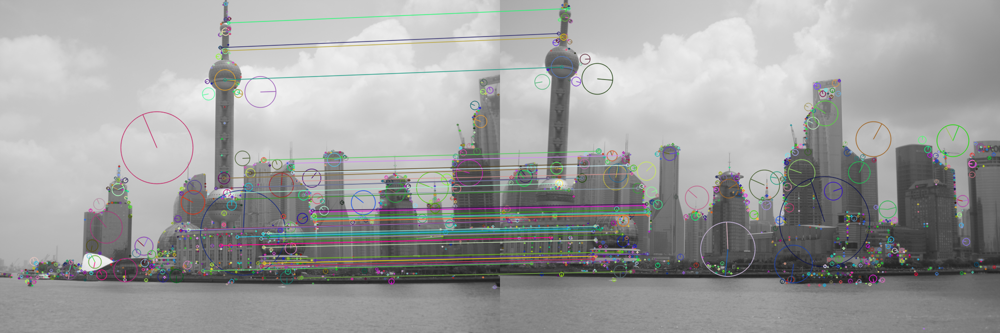

In [ ]:
shang_matches = brute_force_matcher.knnMatch(des1,des3, k=2)
good = []
good_without_list = []
for m,n in shang_matches:  #needs adjustment
    if m.distance < 0.2*n.distance:
        good.append([m])
        good_without_list.append(m)

# cv2.drawMatchesKnn expects list of lists as matches.
shang_13 = cv2.drawMatchesKnn(shanghai1,kp_shang_1,shanghai3,kp_shang_3,good[:50],shanghai3,flags=2)

cv2_imshow(shang_13)

In [ ]:
kps_shang1 = []
kps_shang3 = []
matches_shang=good_without_list[:50]
for match in matches_shang:
    # Get the matching keypoints for each of the images
    img_a_idx = match.queryIdx
    img_b_idx = match.trainIdx
    # Get the coordinates
    (x1,y1) = kp_shang_1[img_a_idx].pt
    (x2,y2) = kp_shang_3[img_b_idx].pt
    # Append to each list
    kps_shang1.append((x1, y1))
    kps_shang3.append((x2, y2))   
kps_shang1 = np.asarray(kps_shang1)
kps_shang3 = np.asarray(kps_shang3)

###Homography Mtrix

In [ ]:
H_shang13=get_homography_matrix(kps_shang1,kps_shang3)
H_shang13

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:24: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.


array([[ 1.13780993e+00, -4.26886839e-02, -3.81916139e+02],
       [ 9.26701689e-02,  1.09744990e+00, -7.56125254e+01],
       [ 1.49479375e-04, -3.63035041e-06,  1.00000000e+00]])

##Verification

In [ ]:
h_veri,status = cv2.findHomography(kps_shang1,kps_shang3)
h_veri

array([[ 1.13908763e+00, -4.27446252e-02, -3.82382983e+02],
       [ 9.34580814e-02,  1.09833327e+00, -7.60196487e+01],
       [ 1.51244081e-04, -3.63216282e-06,  1.00000000e+00]])

###Warping


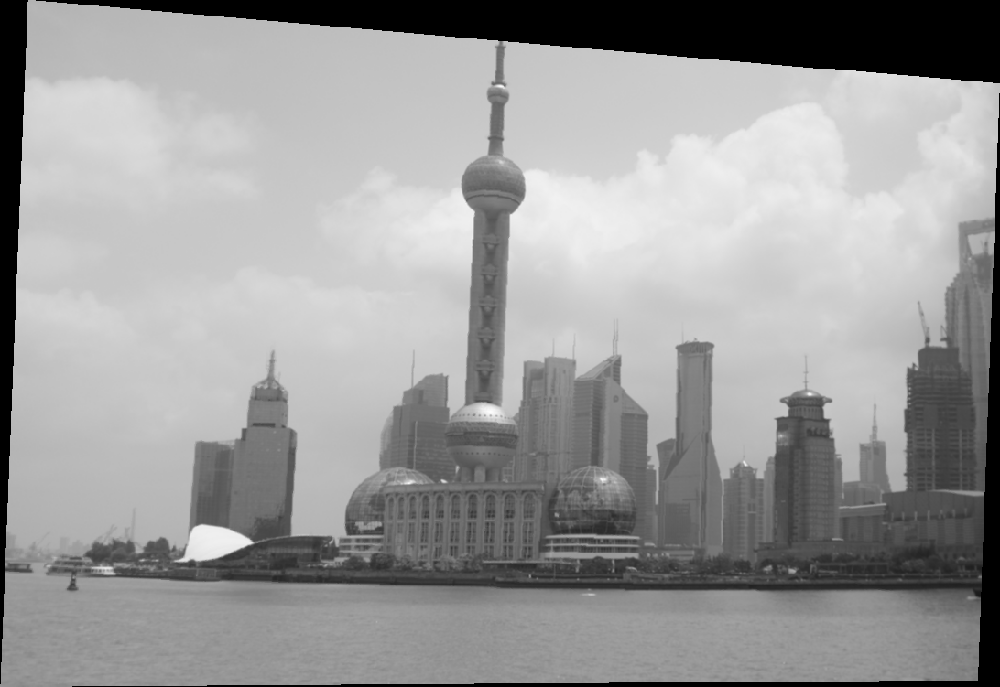

In [ ]:
shiftX, shiftY, warpedImg = warping(shanghai1_copy,H_shang13)
cv2_imshow(warpedImg)

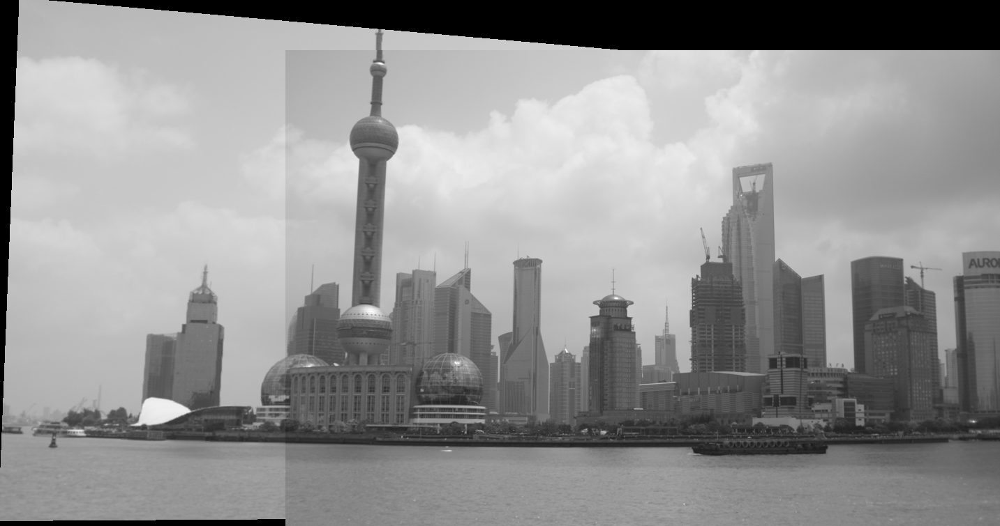

In [ ]:
shanghai13_output = stitchImages(shanghai3_copy, warpedImg, shiftX, shiftY)
cv2_imshow(shanghai13_output)

### 2 images done, now let's add the third

###Get keyPoints

In [ ]:
# find the keypoints and descriptors with SIFT
kp_shang_13, des13 = sift.detectAndCompute(shanghai13_output,None)
kp_shang_2, des2 = sift.detectAndCompute(shanghai2,None)
print ("Found keypoints in image 1: " + str(len(kp_shang_13)))
print ("Found keypoints in image 2: " + str(len(kp_shang_2)))

Found keypoints in image 1: 1505
Found keypoints in image 2: 464


###Finding Matches

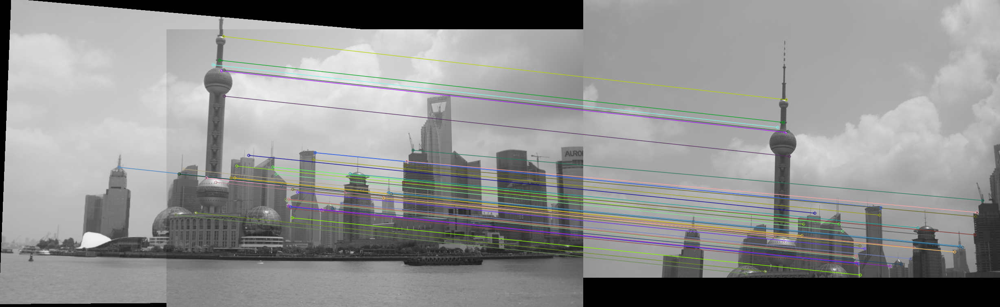

In [ ]:
shang123_matches = brute_force_matcher.knnMatch(des13,des2, k=2)
good = []
good_without_list = []
for m,n in shang123_matches:
    if m.distance < 0.3*n.distance:
        good.append([m])
        good_without_list.append(m)

# cv2.drawMatchesKnn expects list of lists as matches.
shang_123 = cv2.drawMatchesKnn(shanghai13_output,kp_shang_13,shanghai2,kp_shang_2,good[:50],shanghai2,flags=2)

cv2_imshow(shang_123)

In [ ]:
kps_shang13 = []
kps_shang2 = []
matches_shang123=good_without_list[:50]
for match in matches_shang123:
    # Get the matching keypoints for each of the images
    img_a_idx = match.queryIdx
    img_b_idx = match.trainIdx
    # Get the coordinates
    (x1,y1) = kp_shang_13[img_a_idx].pt
    (x2,y2) = kp_shang_2[img_b_idx].pt
    # Append to each list
    kps_shang13.append((x1, y1))
    kps_shang2.append((x2, y2))   
kps_shang13 = np.asarray(kps_shang13)
kps_shang2 = np.asarray(kps_shang2)

###Homography Matrix

In [ ]:
H_shang123=get_homography_matrix(kps_shang13,kps_shang2)
H_shang123

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:24: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.


array([[ 8.21232654e-01, -1.04200487e-02,  1.62828386e+01],
       [-9.03038842e-02,  8.54840397e-01,  2.02136603e+02],
       [-1.07789683e-04, -7.83131344e-05,  1.00000000e+00]])

##Verification

In [ ]:
h_veri, status = cv2.findHomography(kps_shang13,kps_shang2)
h_veri

array([[ 8.21519217e-01, -1.02042546e-02,  1.61646702e+01],
       [-9.04213350e-02,  8.55422565e-01,  2.02121786e+02],
       [-1.07723107e-04, -7.78217731e-05,  1.00000000e+00]])

###Warping

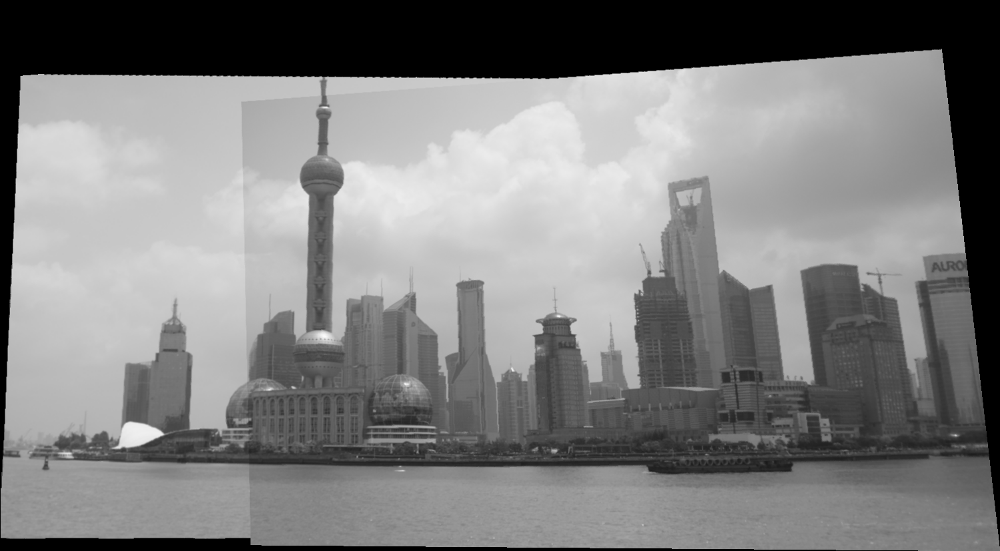

In [ ]:
shiftX, shiftY, warpedImg = warping(shanghai13_output,H_shang123)
cv2_imshow(warpedImg)

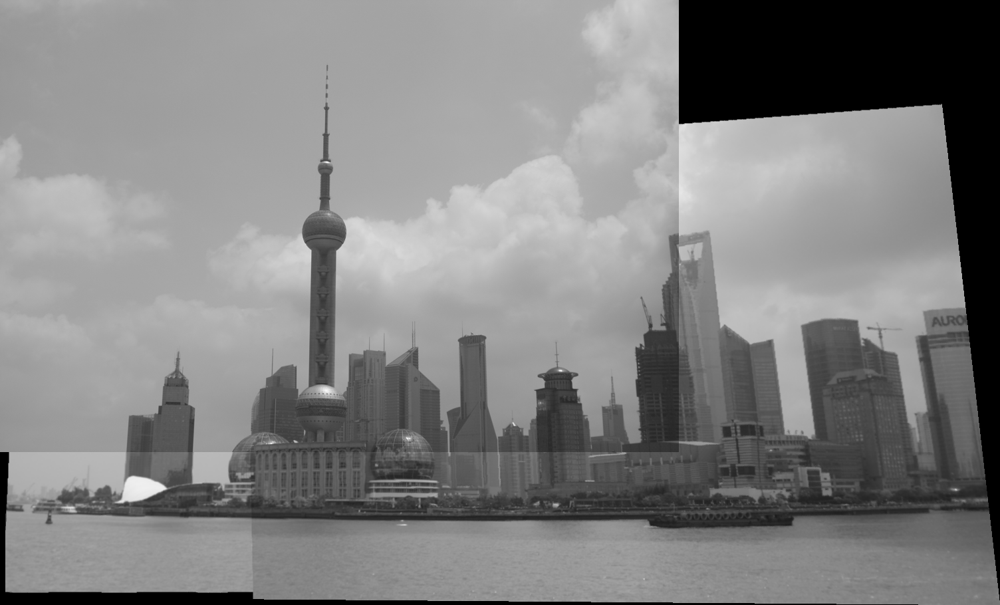

In [ ]:
shanghai123_output = stitchImages(shanghai2, warpedImg, shiftX, shiftY)
cv2_imshow(shanghai123_output)